In [ ]:
!pip uninstall -y sympy
!pip install sympy==1.12

Found existing installation: sympy 1.13.1
Uninstalling sympy-1.13.1:
  Successfully uninstalled sympy-1.13.1
  Using cached sympy-1.12-py3-none-any.whl.metadata (12 kB)
Using cached sympy-1.12-py3-none-any.whl (5.7 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torch 2.6.0+cu124 requires sympy==1.13.1; python_version >= "3.9", but you have sympy 1.12 which is incompatible.


In [ ]:
!pip install gymnasium-connect-four==1.3.1 stable-baselines3==2.0.0

  Using cached sympy-1.13.1-py3-none-any.whl.metadata (12 kB)
Using cached sympy-1.13.1-py3-none-any.whl (6.2 MB)
  Attempting uninstall: sympy
    Found existing installation: sympy 1.12
    Uninstalling sympy-1.12:
      Successfully uninstalled sympy-1.12


In [ ]:
import torch
from torch import nn
import torch.nn.functional as F
import math
import random
import numpy as np
import pandas as pd
from scipy.signal import convolve2d
from IPython.display import HTML
from base64 import b64encode
from sympy import printing
import gymnasium as gym
import itertools
import copy
import time

# Environment specific
from connect_four_gymnasium import ConnectFourEnv
from connect_four_gymnasium.players import BabySmarterPlayer, ChildSmarterPlayer, TeenagerSmarterPlayer, AdultSmarterPlayer
from connect_four_gymnasium.tools import EloLeaderboard
from connect_four_gymnasium.players import (ModelPlayer)

# Plotting imports
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from collections import defaultdict
plt.style.use('fivethirtyeight')
import seaborn as sns


# # Can uncomment if you want to make configuration here
# config_dict = {
#     'device': torch.device('cuda') if torch.cuda.is_available() else 'cpu',
#     'n_filters': 128,              # Number of convolutional filters used in residual blocks
#     'n_res_blocks': 8,             # Number of residual blocks used in network
#     'exploration_constant': 2,     # Exploration constant used in PUCT calculation
#     'temperature': 1.25,           # Selection temperature. A greater temperature is a more uniform distribution
#     'dirichlet_alpha': 1.,         # Alpha parameter for Dirichlet noise. Larger values mean more uniform noise
#     'dirichlet_eps': 0.25,         # Weight of dirichlet noise
#     'learning_rate': 0.001,        # Adam learning rate
#     'training_epochs': 20,         # How many full training epochs, was 50
#     'games_per_epoch': 20,        # How many self-played games per epoch, was 100
#     'minibatch_size': 128,         # Size of each minibatch used in learning update
#     'n_minibatches': 4,            # How many minibatches to accumulate per learning step
#     'mcts_start_search_iter': 30,  # Number of Monte Carlo tree search iterations initially
#     'mcts_max_search_iter': 150,   # Maximum number of MCTS iterations
#     'mcts_search_increment': 1,    # After each epoch, how much should search iterations be increased by
#     }

# Convert to a struct esque object
class Config:
    def __init__(self, dictionary):
        for key, value in dictionary.items():
            setattr(self, key, value)

# config = Config(config_dict)

# Connect Four Class

In [ ]:
class Connect4:
    "Connect 4 game engine, containing methods for game-related tasks."
    def __init__(self):
        self.rows = 6
        self.cols = 7

    def get_next_state(self, state, action, to_play=1):
        "Play an action in a given state and return the resulting board."
        # Pre-condition checks
        assert self.evaluate(state) == 0
        assert np.sum(abs(state)) != self.rows * self.cols
        assert action in self.get_valid_actions(state)

        # Identify next empty row in column
        row = np.where(state[:, action] == 0)[0][-1]

        # Apply action
        new_state = state.copy()
        new_state[row, action] = to_play
        return new_state

    def get_valid_actions(self, state):
        "Return a numpy array containing the indices of valid actions."
        # If game over, no valid moves
        if self.evaluate(state) != 0:
            return np.array([])

        # Identify valid columns to play
        cols = np.sum(np.abs(state), axis=0)
        return np.where((cols // self.rows) == 0)[0]

    def evaluate(self, state):
        "Evaluate the current position. Returns 1 for player 1 win, -1 for player 2 and 0 otherwise."
        # Kernels for checking win conditions
        kernel = np.ones((1, 4), dtype=int)

        # Horizontal and vertical checks
        horizontal_check = convolve2d(state, kernel, mode='valid')
        vertical_check = convolve2d(state, kernel.T, mode='valid')

        # Diagonal checks
        diagonal_kernel = np.eye(4, dtype=int)
        main_diagonal_check = convolve2d(state, diagonal_kernel, mode='valid')
        anti_diagonal_check = convolve2d(state, np.fliplr(diagonal_kernel), mode='valid')

        # Check for winner
        if any(cond.any() for cond in [horizontal_check == 4, vertical_check == 4, main_diagonal_check == 4, anti_diagonal_check == 4]):
            return 1
        elif any(cond.any() for cond in [horizontal_check == -4, vertical_check == -4, main_diagonal_check == -4, anti_diagonal_check == -4]):
            return -1

        # No winner
        return 0

    def step(self, state, action, to_play=1):
        "Play an action in a given state. Return the next_state, reward and done flag."
        # Get new state and reward
        next_state = self.get_next_state(state, action, to_play)
        reward = self.evaluate(next_state)

        # Check for game termination
        done = True if reward != 0 or np.sum(abs(next_state)) >= (self.rows * self.cols - 1) else False
        return next_state, reward, done

    def encode_state(self, state):
        "Convert state to tensor with 3 channels."
        encoded_state = np.stack((state == 1, state == 0, state == -1)).astype(np.float32)
        if len(state.shape) == 3:
            encoded_state = np.swapaxes(encoded_state, 0, 1)
        return encoded_state

    def reset(self):
        "Reset the board."
        return np.zeros([self.rows, self.cols], dtype=np.int8)

# Functions to visualize tree

In [ ]:
def plot_mcts_tree(root, max_depth=4, game=None, filename=None, show_value_path=True):
    """
    Plot the MCTS tree starting from the root node.

    Parameters:
    - root: Root node of the MCTS tree
    - max_depth: Maximum depth to visualize (default: 4)
    - game: Game instance for state visualization (optional)
    - filename: If provided, save the plot to this filename instead of showing
    - show_value_path: If True, highlights both visit-based and value-based optimal paths
    """
    plt.figure(figsize=(24, 12))

    # Counter for node placement at each level
    level_counters = defaultdict(int)
    positions = {}  # Store positions of all nodes

    # Function to compute the width based on depth
    def get_width(depth):
        return 2 ** min(depth, 5)  # Limit exponential growth for deeper levels

    # BFS traversal to assign positions
    queue = [(root, 0)]  # (node, depth)
    max_width = get_width(max_depth)

    while queue:
        node, depth = queue.pop(0)

        if depth > max_depth:
            continue

        # Assign position
        level_width = get_width(depth)
        x_pos = (level_counters[depth] + 0.5) * (max_width / level_width)
        y_pos = -depth

        # Store node position
        node_id = id(node)
        positions[node_id] = (x_pos, y_pos, node)

        level_counters[depth] += 1

        # Enqueue children
        for action, child in sorted(node.children.items()):
            queue.append((child, depth + 1))

    # Draw edges
    for node_id, (x, y, node) in positions.items():
        for action, child in node.children.items():
            child_id = id(child)
            if isinstance(action, tuple):
                action_label = action[0]
            else:
                action_label = action
            if child_id in positions:
                child_x, child_y, _ = positions[child_id]
                plt.plot([x, child_x], [y, child_y], 'k-', alpha=0.5)

                # Add action label on the edge
                mid_x = (x + child_x) / 2
                mid_y = (y + child_y) / 2
                plt.text(mid_x, mid_y, f"{action_label}", fontsize=9,
                         bbox=dict(facecolor='white', alpha=0.9, edgecolor='black'),
                         ha='center', va='center')

    # Find best paths (by visits and by value)
    best_visit_path = find_best_path(root, criterion='visits')
    best_visit_path_nodes = set(id(node) for node in best_visit_path)

    # Only compute value path if requested
    if show_value_path:
        best_value_path = find_best_path(root, criterion='value')
        best_value_path_nodes = set(id(node) for node in best_value_path)
    else:
        best_value_path_nodes = set()

    # Draw nodes
    for node_id, (x, y, node) in positions.items():
        size = 1000 + 1000 * min(1, math.sqrt(node.n_visits / max(1, root.n_visits)))

        # Calculate node color based on value
        value = node.get_value()
        # Map value from [-1, 1] to color
        color = plt.cm.RdYlGn((value + 1) / 2)

        # Determine edge color and style based on which paths the node belongs to
        if node_id in best_visit_path_nodes and node_id in best_value_path_nodes:
            # Node is on both best visit path and best value path
            edge_color = 'purple'
            linewidth = 3
        elif node_id in best_visit_path_nodes:
            # Node is only on best visit path
            edge_color = 'red'
            linewidth = 2
        elif node_id in best_value_path_nodes:
            # Node is only on best value path
            edge_color = 'blue'
            linewidth = 2
        else:
            # Node is not on any special path
            edge_color = 'black'
            linewidth = 1

        plt.scatter(x, y, s=size, c=[color], edgecolors=edge_color, linewidth=linewidth, zorder=3)

        # Node label showing visits and value
        visits_text = f"n={node.n_visits}"
        value_text = f"v={value:.2f}"
        prob_text = f"p={node.prob:.2f}" if node.prob > 0 else ""

        label = f"{visits_text}\n{value_text}"
        if prob_text:
            label += f"\n{prob_text}"

        plt.annotate(label, (x, y), ha='center', va='center', fontsize=8)

    # Add color bar to show value mapping
    sm = plt.cm.ScalarMappable(cmap=plt.cm.RdYlGn, norm=plt.Normalize(-1, 1))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=plt.gca(), orientation='horizontal', pad=0.05, fraction=0.05)
    cbar.set_label('Node Value (-1 to 1)')

    # Add legends for node size and path types
    handles = []
    labels = []

    # Node size legend
    for visits_ratio in [0.01, 0.1, 0.5, 1.0]:
        size = 1000 + 1000 * min(1, math.sqrt(visits_ratio))
        handles.append(plt.scatter([], [], s=size, c='gray', edgecolor='black'))
        labels.append(f"{int(visits_ratio * root.n_visits)} visits")

    # Path type legend
    handles.append(plt.Line2D([], [], color='red', linewidth=2, marker='o', markersize=10,
                             markerfacecolor='lightblue', markeredgecolor='red'))
    labels.append('Most visited path')

    handles.append(plt.Line2D([], [], color='blue', linewidth=2, marker='o', markersize=10,
                             markerfacecolor='lightblue', markeredgecolor='blue'))
    labels.append('Highest value path')

    handles.append(plt.Line2D([], [], color='purple', linewidth=3, marker='o', markersize=10,
                             markerfacecolor='lightblue', markeredgecolor='purple'))
    labels.append('On both paths')

    plt.legend(handles, labels, title="Tree Information", loc='upper right',
               bbox_to_anchor=(0.95, 0.9), frameon=True, fancybox=True,
               labelspacing=3)

    plt.title(f"AlphaFour MCTS Tree (Total Iterations: {root.n_visits})\n")
    plt.axis('off')
    plt.tight_layout()

    if filename:
        plt.savefig(filename, dpi=300, bbox_inches='tight')
    else:
        plt.show()

def find_best_path(root, criterion='visits'):
    """
    Find the best path from root to leaf based on specified criterion.

    Parameters:
    - root: Root node of the MCTS tree
    - criterion: 'visits' for highest visit count path or 'value' for highest value path

    Returns:
    - List of nodes representing the best path
    """
    path = [root]
    current = root

    while current.children:
        if criterion == 'visits':
            # Find the child with the highest visit count
            best_action = max(current.children.items(), key=lambda x: x[1].n_visits)[0]
        elif criterion == 'value':
            # Find the child with the highest value
            # Note: For opponent's turn (to_play = -1), we want the minimum value
            if current.to_play == 1:
                best_action = max(current.children.items(), key=lambda x: x[1].get_value())[0]
            else:
                best_action = min(current.children.items(), key=lambda x: x[1].get_value())[0]
        else:
            raise ValueError(f"Unknown criterion: {criterion}")

        current = current.children[best_action]
        path.append(current)

    return path

def visualize_game_state(game_state, game):
    """
    Create a visualization of the game state using matplotlib.
    This is an example for Connect Four - customize for your specific game.

    Parameters:
    - game_state: The state to visualize
    - game: Game instance with necessary methods

    Returns:
    - matplotlib figure with the visualization
    """
    # Example for Connect Four
    if hasattr(game, 'rows') and hasattr(game, 'cols'):
        rows, cols = game.rows, game.cols

        fig, ax = plt.subplots(figsize=(cols, rows))

        # Assuming state is a 2D array or can be reshaped into one
        # with 0 for empty, 1 for player 1, -1 for player 2
        for r in range(rows):
            for c in range(cols):
                # Get cell value (modify this based on your state representation)
                if hasattr(game, 'get_cell_value'):
                    cell = game.get_cell_value(game_state, r, c)
                else:
                    # Assume state is a 2D array
                    try:
                        cell = game_state[r][c]
                    except:
                        cell = 0

                # Draw cell
                if cell == 0:
                    color = 'white'
                elif cell == 1:
                    color = 'red'
                else:
                    color = 'yellow'

                circle = plt.Circle((c + 0.5, rows - r - 0.5), 0.4, color=color, ec='black')
                ax.add_patch(circle)

        # Set limits and remove axes
        ax.set_xlim(0, cols)
        ax.set_ylim(0, rows)
        ax.set_aspect('equal')
        ax.axis('off')

        return fig
    else:
        # Generic visualization - can be customized for other games
        fig, ax = plt.subplots(figsize=(5, 5))
        ax.text(0.5, 0.5, "Game state visualization not implemented",
                ha='center', va='center')
        ax.axis('off')
        return fig

In [ ]:
class ResNet(nn.Module):
    "Complete residual neural network model."
    def __init__(self, game, config):
        super().__init__()

        # Board dimensions
        self.board_size = (game.rows, game.cols)
        n_actions = game.cols  # Number of columns represent possible actions
        n_filters = config.n_filters

        self.base = ConvBase(config)  # Base layers

        # Policy head for choosing actions
        self.policy_head = nn.Sequential(
            nn.Conv2d(n_filters, n_filters//4, kernel_size=3, padding=1),
            nn.BatchNorm2d(n_filters//4),
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(n_filters//4 * self.board_size[0] * self.board_size[1], n_actions)
        )

        # Value head for evaluating board states
        self.value_head = nn.Sequential(
            nn.Conv2d(n_filters, n_filters//32, kernel_size=3, padding=1),
            nn.BatchNorm2d(n_filters//32),
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(n_filters//32 * self.board_size[0] * self.board_size[1], 1),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.base(x)
        x_value = self.value_head(x)
        x_policy = self.policy_head(x)
        return x_value, x_policy

class ConvBase(nn.Module):
    "Convolutional base for the network."
    def __init__(self, config):
        super().__init__()

        n_filters = config.n_filters
        n_res_blocks = config.n_res_blocks

        # Initial convolutional layer
        self.conv = nn.Sequential(
            nn.Conv2d(3, n_filters, kernel_size=3, padding=1),
            nn.BatchNorm2d(n_filters),
            nn.ReLU()
        )

        # List of residual blocks
        self.res_blocks = nn.ModuleList(
            [ResidualBlock(n_filters) for _ in range(n_res_blocks)]
        )

    def forward(self, x):
        x = self.conv(x)
        for block in self.res_blocks:
            x = block(x)
        return x

class ResidualBlock(nn.Module):
    "Residual block, the backbone of a ResNet."
    def __init__(self, n_filters):
        super().__init__()

        # Two convolutional layers, both with batch normalization
        self.conv_1 = nn.Conv2d(n_filters, n_filters, kernel_size=3, padding=1)
        self.batch_norm_1 = nn.BatchNorm2d(n_filters)
        self.conv_2 = nn.Conv2d(n_filters, n_filters, kernel_size=3, padding=1)
        self.batch_norm_2 = nn.BatchNorm2d(n_filters)
        self.relu = nn.ReLU()

    def forward(self, x):
        # Pass x through layers and add skip connection
        output = self.relu(self.batch_norm_1(self.conv_1(x)))
        output = self.batch_norm_2(self.conv_2(output))
        return self.relu(output + x)

In [ ]:
class MCTS:
    def __init__(self, network, game, config):
        "Initialize Monte Carlo Tree Search with a given neural network, game instance, and configuration."
        self.network = network
        self.game = game
        self.config = config

    def search(self, state, total_iterations, temperature=None):
        "Performs a search for the desired number of iterations, returns an action and the tree root."
        # Create the root
        root = Node(None, state, 1, self.game, self.config)

        # Expand the root, adding noise to each action
        # Get valid actions
        valid_actions = self.game.get_valid_actions(state)
        state_tensor = torch.tensor(self.game.encode_state(state), dtype=torch.float).unsqueeze(0).to(self.config.device)
        with torch.no_grad():
            self.network.eval()
            value, logits = self.network(state_tensor)

        # Get action probabilities
        action_probs = F.softmax(logits.view(self.game.cols), dim=0).cpu().numpy()

        # Calculate and add dirichlet noise
        noise = np.random.dirichlet([self.config.dirichlet_alpha] * self.game.cols)
        action_probs = ((1 - self.config.dirichlet_eps) * action_probs) + self.config.dirichlet_eps * noise

        # Mask unavailable actions
        mask = np.full(self.game.cols, False)
        mask[valid_actions] = True
        action_probs = action_probs[mask]

        # Softmax
        action_probs /= np.sum(action_probs)

        # Create a child for each possible action
        for action, prob in zip(valid_actions, action_probs):
            child_state = -self.game.get_next_state(state, action)
            root.children[action] = Node(root, child_state, -1, self.game, self.config)
            root.children[action].prob = prob

        # Since we're not backpropagating, manually increase visits
        root.n_visits = 1
        # Set value as neural network prediction also as it will slightly improve the accuracy of the value target later
        root.total_score = value.item()

        # Begin search
        for _ in range(total_iterations):
            current_node = root

            # Phase 1: Selection
            # While not currently on a leaf node, select a new node using PUCT score
            while not current_node.is_leaf():
                current_node = current_node.select_child()

            # Phase 2: Expansion
            # When a leaf node is reached and it's not terminal; expand it
            if not current_node.is_terminal():
                current_node.expand()
                # Convert node state to tensor and pass through network
                state_tensor = torch.tensor(self.game.encode_state(current_node.state), dtype=torch.float).unsqueeze(0).to(self.config.device)
                with torch.no_grad():
                    self.network.eval()
                    value, logits = self.network(state_tensor)
                    value = value.item()

                # Mask invalid actions, then calculate masked action probs
                mask = np.full(self.game.cols, False)
                mask[valid_actions] = True
                action_probs = F.softmax(logits.view(self.game.cols)[mask], dim=0).cpu().numpy()
                for child, prob in zip(current_node.children.values(), action_probs):
                    child.prob = prob
            # If node is terminal, get the value of it from game instance
            else:
                value = self.game.evaluate(current_node.state)

            # Phase 3: Backpropagation
            # Backpropagate the value of the leaf to the root
            current_node.backpropagate(value)

        # Select action with specified temperature
        if temperature == None:
            temperature = self.config.temperature
        return self.select_action(root, temperature), root

    def select_action(self, root, temperature=None):
        "Select an action from the root based on visit counts, adjusted by temperature, 0 temp for greedy."
        if temperature == None:
            temperature = self.config.temperature
        action_counts = {key: val.n_visits for key, val in root.children.items()}
        if temperature == 0:
            return max(action_counts, key=action_counts.get)
        elif temperature == np.inf:
            return np.random.choice(list(action_counts.keys()))
        else:
            distribution = np.array([*action_counts.values()]) ** (1 / temperature)
            return np.random.choice([*action_counts.keys()], p=distribution/sum(distribution))

class Node:
    def __init__(self, parent, state, to_play, game, config):
        "Represents a node in the MCTS, holding the game state and statistics for MCTS to operate."
        self.parent = parent
        self.state = state
        self.to_play = to_play
        self.config = config
        self.game = game

        self.prob = 0
        self.children = {}
        self.n_visits = 0
        self.total_score = 0

    def expand(self):
        "Create child nodes for all valid actions. If state is terminal, evaluate and set the node's value."
        # Get valid actions
        valid_actions = self.game.get_valid_actions(self.state)

        # If there are no valid actions, state is terminal, so get value using game instance
        if len(valid_actions) == 0:
            self.total_score = self.game.evaluate(self.state)
            return

        # Create a child for each possible action
        for action in zip(valid_actions):
            # Make move, then flip board to perspective of next player
            child_state = -self.game.get_next_state(self.state, action)
            self.children[action] = Node(self, child_state, -self.to_play, self.game, self.config)

    def select_child(self):
        "Select the child node with the highest PUCT score."
        best_puct = -np.inf
        best_child = None
        for child in self.children.values():
            puct = self.calculate_puct(child)
            if puct > best_puct:
                best_puct = puct
                best_child = child
        return best_child

    def calculate_puct(self, child):
        "Calculate the PUCT score for a given child node."
        # Scale Q(s,a) so it's between 0 and 1 so it's comparable to a probability
        # Using 1 - Q(s,a) because it's from the perspectve of the child – the opposite of the parent
        exploitation_term = 1 - (child.get_value() + 1) / 2
        exploration_term = child.prob * math.sqrt(self.n_visits) / (child.n_visits + 1)
        return exploitation_term + self.config.exploration_constant * exploration_term

    def backpropagate(self, value):
        "Update the current node and its ancestors with the given value."
        self.total_score += value
        self.n_visits += 1
        if self.parent is not None:
            # Backpropagate the negative value so it switches each level
            self.parent.backpropagate(-value)

    def is_leaf(self):
        "Check if the node is a leaf (no children)."
        return len(self.children) == 0

    def is_terminal(self):
        "Check if the node represents a terminal state."
        return (self.n_visits != 0) and (len(self.children) == 0)

    def get_value(self):
        "Calculate the average value of this node."
        if self.n_visits == 0:
            return 0
        return self.total_score / self.n_visits

    def __str__(self):
        "Return a string containing the node's relevant information for debugging purposes."
        return (f"State:\n{self.state}\nProb: {self.prob}\nTo play: {self.to_play}" +
                f"\nNumber of children: {len(self.children)}\nNumber of visits: {self.n_visits}" +
                f"\nTotal score: {self.total_score}")

In [ ]:
class AlphaZero:
    def __init__(self, game, config, verbose=True):
        self.network = ResNet(game, config).to(config.device)
        self.mcts = MCTS(self.network, game, config)
        self.game = game
        self.config = config

        # Losses and optimizer
        self.loss_cross_entropy = nn.CrossEntropyLoss()
        self.loss_mse = nn.MSELoss()
        self.optimizer = torch.optim.Adam(self.network.parameters(), lr=config.learning_rate, weight_decay=0.0001)

        # Pre-allocate memory on GPU
        state_shape = game.encode_state(game.reset()).shape
        self.max_memory = config.minibatch_size * config.n_minibatches
        self.state_memory = torch.zeros(self.max_memory, *state_shape).to(config.device)
        self.value_memory = torch.zeros(self.max_memory, 1).to(config.device)
        self.policy_memory = torch.zeros(self.max_memory, game.cols).to(config.device)
        self.current_memory_index = 0
        self.memory_full = False

        # MCTS search iterations
        self.search_iterations = config.mcts_start_search_iter

        # Logging
        self.verbose = verbose
        self.total_games = 0

        # Loss tracking for plotting
        self.policy_losses = []
        self.value_losses = []
        self.total_losses = []
        self.epoch_policy_losses = []
        self.epoch_value_losses = []
        self.epoch_total_losses = []

        # Training history
        self.training_history = {
            'epochs': [],
            'policy_losses': [],
            'value_losses': [],
            'total_losses': []
        }

    def train(self, training_epochs, last_epoch):
        "Train the AlphaZero agent for a specified number of training epochs."
        # For each training epoch
        visualize_tree = False
        for epoch in range(training_epochs):

            # Reset epoch-specific loss tracking
            self.epoch_policy_losses = []
            self.epoch_value_losses = []
            self.epoch_total_losses = []

            # Play specified number of games
            for num_games_in_epoch in range(self.config.games_per_epoch):
                # Only visualize tree in last epoch
                if last_epoch and num_games_in_epoch == self.config.games_per_epoch - 1:
                    visualize_tree = True
                self.self_play(visualize_tree)

            # Compute average losses for this epoch
            if self.epoch_policy_losses:  # Only if we had losses in this epoch
                avg_policy_loss = sum(self.epoch_policy_losses) / len(self.epoch_policy_losses)
                avg_value_loss = sum(self.epoch_value_losses) / len(self.epoch_value_losses)
                avg_total_loss = sum(self.epoch_total_losses) / len(self.epoch_total_losses)

                # Store average losses for plotting
                self.policy_losses.append(avg_policy_loss)
                self.value_losses.append(avg_value_loss)
                self.total_losses.append(avg_total_loss)

                # Update training history
                current_epoch = len(self.training_history['epochs']) + 1
                self.training_history['epochs'].append(current_epoch)
                self.training_history['policy_losses'].append(avg_policy_loss)
                self.training_history['value_losses'].append(avg_value_loss)
                self.training_history['total_losses'].append(avg_total_loss)

                if self.verbose:
                    print(f"\nEpoch {epoch+1}: Policy Loss: {avg_policy_loss:.4f}, Value Loss: {avg_value_loss:.4f}, Total Loss: {avg_total_loss:.4f}")

            # At the end of each epoch, increase the number of MCTS search iterations
            self.search_iterations = min(self.config.mcts_max_search_iter, self.search_iterations + self.config.mcts_search_increment)

    def self_play(self, visualize_tree):
        "Perform one episode of self-play."
        state = self.game.reset()
        done = False
        # visualized_tree = False # uncomment if we just want one tree
        while not done:
            # Search for a move
            action, root = self.mcts.search(state, self.search_iterations)

            # Visualize the tree if last game is being played and we haven't visualized one yet
            # visualize_tree = False # so we don't print trees for tuning
            if visualize_tree:
                plot_mcts_tree(root, max_depth=2)  # Limit to 2 levels deep for clarity

            # Value target is the value of the MCTS root node
            value = root.get_value()

            # Visit counts used to compute policy target
            visits = np.zeros(self.game.cols)
            for child_action, child in root.children.items():
                visits[child_action] = child.n_visits
            # Softmax so distribution sums to 1
            visits /= np.sum(visits)

            # Append state + value & policy targets to memory
            self.append_to_memory(state, value, visits)

            # If memory is full, perform a learning step
            if self.memory_full:
                self.learn()

            # Perform action in game
            state, _, done = self.game.step(state, action)

            # Flip the board
            state = -state

        # Increment total games played
        self.total_games += 1

        # Logging if verbose
        if self.verbose:
            print("\rTotal Games:", self.total_games, "Items in Memory:", self.current_memory_index, "Search Iterations:", self.search_iterations, end="")

    def append_to_memory(self, state, value, visits):
        """
        Append state and MCTS results to memory buffers.
        Args:
            state (array-like): Current game state.
            value (float): MCTS value for the game state.
            visits (array-like): MCTS visit counts for available moves.
        """
        # Calculate the encoded states
        encoded_state = np.array(self.game.encode_state(state))
        encoded_state_augmented = np.array(self.game.encode_state(state[:, ::-1]))

        # Stack states and visits
        states_stack = np.stack((encoded_state, encoded_state_augmented), axis=0)
        visits_stack = np.stack((visits, visits[::-1]), axis=0)

        # Convert the stacks to tensors
        state_tensor = torch.tensor(states_stack, dtype=torch.float).to(self.config.device)
        visits_tensor = torch.tensor(visits_stack, dtype=torch.float).to(self.config.device)
        value_tensor = torch.tensor(np.array([value, value]), dtype=torch.float).to(self.config.device).unsqueeze(1)

        # Store in pre-allocated GPU memory
        self.state_memory[self.current_memory_index:self.current_memory_index + 2] = state_tensor
        self.value_memory[self.current_memory_index:self.current_memory_index + 2] = value_tensor
        self.policy_memory[self.current_memory_index:self.current_memory_index + 2] = visits_tensor

        # Increment index, handle overflow
        self.current_memory_index = (self.current_memory_index + 2) % self.max_memory

        # Set memory filled flag to True if memory is full
        if (self.current_memory_index == 0) or (self.current_memory_index == 1):
            self.memory_full = True


    def learn(self):
        "Update the neural network by extracting minibatches from memory and performing one step of optimization for each one."
        self.network.train()

        # Create a randomly shuffled list of batch indices
        batch_indices = np.arange(self.max_memory)
        np.random.shuffle(batch_indices)

        for batch_index in range(self.config.n_minibatches):
            # Get minibatch indices
            start = batch_index * self.config.minibatch_size
            end = start + self.config.minibatch_size
            mb_indices = batch_indices[start:end]

            # Slice memory tensors
            mb_states = self.state_memory[mb_indices]
            mb_value_targets = self.value_memory[mb_indices]
            mb_policy_targets = self.policy_memory[mb_indices]

            # Network predictions
            value_preds, policy_logits = self.network(mb_states)

            # Loss calculation
            policy_loss = self.loss_cross_entropy(policy_logits, mb_policy_targets)
            value_loss = self.loss_mse(value_preds.view(-1), mb_value_targets.view(-1))
            loss = policy_loss + value_loss

            # Store losses for this batch
            self.epoch_policy_losses.append(policy_loss.item())
            self.epoch_value_losses.append(value_loss.item())
            self.epoch_total_losses.append(loss.item())

            # Backward pass
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()

        self.memory_full = False
        self.network.eval()

    def get_training_history(self):
        """
        Returns the training history dictionary.
        Returns:
            dict: Dictionary containing training metrics.
        """
        return self.training_history

    def save(self, filepath):
        torch.save({
            'model_state_dict': self.network.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
            'training_history': self.training_history
        }, filepath)
        if self.verbose:
            print(f"Model saved to {filepath}")

    def load(self, filepath):
        checkpoint = torch.load(filepath, map_location=self.config.device)
        self.network.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        self.training_history = checkpoint.get('training_history', {})
        self.network.eval()  # Set to eval mode by default
        if self.verbose:
            print(f"Model loaded from {filepath}")


In [ ]:
class Evaluator:
    "Class to evaluate the policy network's performance on simple moves."
    def __init__(self, alphazero, num_examples=500, verbose=True):
        self.network = alphazero.network
        self.game = alphazero.game
        self.config = alphazero.config
        self.accuracies = []
        self.num_examples = num_examples
        self.verbose = verbose

        # Generate and prepare example states and actions for evaluation
        self.generate_examples()

    def select_action(self, state):
        "Select an action based on the given state, will choose a winning or blocking moves."
        valid_actions = self.game.get_valid_actions(state)

        # Check for a winning move
        for action in valid_actions:
            next_state, reward, _ = self.game.step(state, action)
            if reward == 1:
                return action

        # Check for a blocking move
        flipped_state = -state
        for action in valid_actions:
            next_state, reward, _ = self.game.step(flipped_state, action)
            if reward == 1:
                return action

        # Default to random action if no winning or blocking move
        return random.choice(valid_actions)

    def generate_examples(self):
        "Generate and prepare example states and actions for evaluation."
        winning_examples = self.generate_examples_for_condition('win')
        blocking_examples = self.generate_examples_for_condition('block')

        # Prepare states and actions for evaluation
        winning_example_states, winning_example_actions = zip(*winning_examples)
        blocking_example_states, blocking_example_actions = zip(*blocking_examples)

        target_states = np.concatenate([winning_example_states, blocking_example_states], axis=0)
        target_actions = np.concatenate([winning_example_actions, blocking_example_actions], axis=0)

        encoded_states = [self.game.encode_state(state) for state in target_states]
        self.X_target = torch.tensor(np.stack(encoded_states, axis=0), dtype=torch.float).to(self.config.device)
        self.y_target = torch.tensor(target_actions, dtype=torch.long).to(self.config.device)

    def generate_examples_for_condition(self, condition):
        "Generate examples based on either 'win' or 'block' conditions."
        examples = []
        while len(examples) < self.num_examples:
            state = self.game.reset()
            while True:
                action = self.select_action(state)
                next_state, reward, done = self.game.step(state, action, to_play=1)

                if condition == 'win' and reward == 1:
                    examples.append((state, action))
                    break

                if done:
                    break

                state = next_state

                # Flipping the board for opponent's perspective
                action = self.select_action(-state)
                next_state, reward, done = self.game.step(state, action, to_play=-1)

                if condition == 'block' and reward == -1:
                    examples.append((-state, action))
                    break

                if done:
                    break

                state = next_state
        return examples

    def evaluate(self):
        "Evaluate the policy network's accuracy and append it to self.accuracies."
        with torch.no_grad():
            self.network.eval()
            _, logits = self.network(self.X_target)
            pred_actions = logits.argmax(dim=1)
            accuracy = (pred_actions == self.y_target).float().mean().item()

        self.accuracies.append(accuracy)
        if self.verbose:
            print(f"Initial Evaluation Accuracy: {100 * accuracy:.1f}%")

# Tuning (uncomment to tune, and comment out training)

In [ ]:
# # Your original config dictionary
# base_config_dict = {
#     'device': torch.device('cuda') if torch.cuda.is_available() else 'cpu',
#     'n_filters': 128,
#     'n_res_blocks': 8,
#     'exploration_constant': 2,
#     'temperature': 1.25,
#     'dirichlet_alpha': 1.,
#     'dirichlet_eps': 0.25,
#     'learning_rate': 0.001,
#     'training_epochs': 10, # was 20, do 10
#     'games_per_epoch': 10, # was 20, do 10
#     'minibatch_size': 128,
#     'n_minibatches': 4,
#     'mcts_start_search_iter': 30,
#     'mcts_max_search_iter': 150,
#     'mcts_search_increment': 1,
# }

# # Parameter options
# exploration_constants = [1.0, 2.0]
# temperatures = [1.0, 1.25]
# dirichlet_pairs = [(0.3, 0.2), (1.0, 0.25)]
# resblock_filter_pairs = [(4, 64), (8, 128)]

# # All combinations
# combinations = list(itertools.product(
#     exploration_constants,
#     temperatures,
#     dirichlet_pairs,
#     resblock_filter_pairs
# ))

# # Results storage
# results = []

# # Main tuning loop
# for idx, (exploration_const, temp, (alpha, eps), (n_blocks, n_filters)) in enumerate(combinations):
#     print(f"\n=== Running Config {idx + 1}/{len(combinations)} ===")
#     config_dict = copy.deepcopy(base_config_dict)
#     config_dict.update({
#         'exploration_constant': exploration_const,
#         'temperature': temp,
#         'dirichlet_alpha': alpha,
#         'dirichlet_eps': eps,
#         'n_res_blocks': n_blocks,
#         'n_filters': n_filters,
#     })
#     config = Config(config_dict)

#     # Create game, agent, evaluator
#     game = Connect4()
#     alphazero = AlphaZero(game, config)
#     evaluator = Evaluator(alphazero)

#     # Pre-training evaluation
#     evaluator.evaluate()

#     # Train + Evaluate
#     last_epoch = False

#     train_start_time = time.time()
#     for train_epoch in range(config.training_epochs):
#         if train_epoch == config.training_epochs - 1:
#             last_epoch = True
#         alphazero.train(1, last_epoch)
#         evaluator.evaluate()
#     train_end_time = time.time()

#     # Total time
#     total_train_time = train_end_time - train_start_time

#     # Get evaluation stats
#     final_acc = evaluator.accuracies[-1]
#     avg_acc = sum(evaluator.accuracies) / len(evaluator.accuracies)

#     # Get training history
#     history = alphazero.get_training_history()
#     final_policy_loss = history['policy_losses'][-1]
#     avg_policy_loss = sum(history['policy_losses']) / len(history['policy_losses'])
#     final_value_loss = history['value_losses'][-1]
#     avg_value_loss = sum(history['value_losses']) / len(history['value_losses'])

#     results_dict = {
#         'exploration_const': config.exploration_constant,
#         'temperature': config.temperature,
#         'dirichlet_alpha': config.dirichlet_alpha,
#         'dirichlet_eps': config.dirichlet_eps,
#         'n_res_blocks': config.n_res_blocks,
#         'n_filters': config.n_filters,
#         'final_acc': final_acc,
#         'avg_acc': avg_acc,
#         'final_policy_loss': final_policy_loss,
#         'avg_policy_loss': avg_policy_loss,
#         'final_value_loss': final_value_loss,
#         'avg_value_loss': avg_value_loss,
#         'total_train_time': total_train_time
#     }


#     print(results_dict)

#     # Store results
#     results.append(results_dict)

# # Print all the results for each configuration
# for result in results:
#     print("Configuration:")
#     print(f"  Exploration Constant: {result['exploration_const']}")
#     print(f"  Temperature: {result['temperature']}")
#     print(f"  Dirichlet Alpha: {result['dirichlet_alpha']}")
#     print(f"  Dirichlet Epsilon: {result['dirichlet_eps']}")
#     print(f"  Residual Blocks: {result['n_res_blocks']}")
#     print(f"  Filters: {result['n_filters']}")
#     print(f"Final Accuracy: {result['final_acc'] * 100:.2f}%")
#     print(f"Average Accuracy: {result['avg_acc'] * 100:.2f}%")
#     print(f"Final Policy Loss: {result['final_policy_loss']:.4f}")
#     print(f"Average Policy Loss: {result['avg_policy_loss']:.4f}")
#     print(f"Final Value Loss: {result['final_value_loss']:.4f}")
#     print(f"Average Value Loss: {result['avg_value_loss']:.4f}")
#     print(f"Total Train Time: {result['total_train_time']:.4f}")
#     print("-" * 40)  # Separator for clarity

# Set up game for final model

In [ ]:
# Your original config dictionary
best_config_dict = {
    'device': torch.device('cuda') if torch.cuda.is_available() else 'cpu',
    'n_filters': 64, # tuned
    'n_res_blocks': 4, # tuned
    'exploration_constant': 2, # tuned
    'temperature': 1.0, # tuned
    'dirichlet_alpha': 1., # tuned
    'dirichlet_eps': 0.25, # tuned
    'learning_rate': 0.001,
    'training_epochs': 50,
    'games_per_epoch': 100,
    'minibatch_size': 128,
    'n_minibatches': 4,
    'mcts_start_search_iter': 30,
    'mcts_max_search_iter': 150,
    'mcts_search_increment': 1,
}

config = Config(best_config_dict)

game = Connect4()
alphazero = AlphaZero(game, config)
evaluator = Evaluator(alphazero)

# Evaluate pre training
evaluator.evaluate()

Initial Evaluation Accuracy: 14.1%


# Train

Total Games: 100 Items in Memory: 200 Search Iterations: 30
Epoch 1: Policy Loss: 1.9730, Value Loss: 0.0591, Total Loss: 2.0322
Initial Evaluation Accuracy: 20.7%
Total Games: 200 Items in Memory: 210 Search Iterations: 31
Epoch 1: Policy Loss: 1.9426, Value Loss: 0.0290, Total Loss: 1.9716
Initial Evaluation Accuracy: 15.7%
Total Games: 300 Items in Memory: 214 Search Iterations: 32
Epoch 1: Policy Loss: 1.9320, Value Loss: 0.0243, Total Loss: 1.9563
Initial Evaluation Accuracy: 24.9%
Total Games: 400 Items in Memory: 170 Search Iterations: 33
Epoch 1: Policy Loss: 1.9168, Value Loss: 0.0323, Total Loss: 1.9491
Initial Evaluation Accuracy: 27.1%
Total Games: 500 Items in Memory: 102 Search Iterations: 34
Epoch 1: Policy Loss: 1.9091, Value Loss: 0.0376, Total Loss: 1.9467
Initial Evaluation Accuracy: 32.0%
Total Games: 600 Items in Memory: 296 Search Iterations: 35
Epoch 1: Policy Loss: 1.8426, Value Loss: 0.0386, Total Loss: 1.8811
Initial Evaluation Accuracy: 34.5%
Total Games: 700

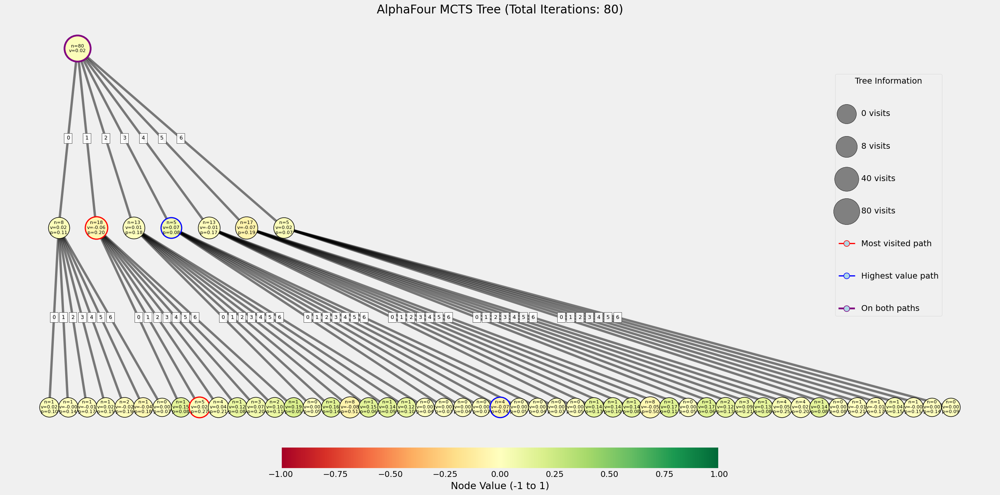

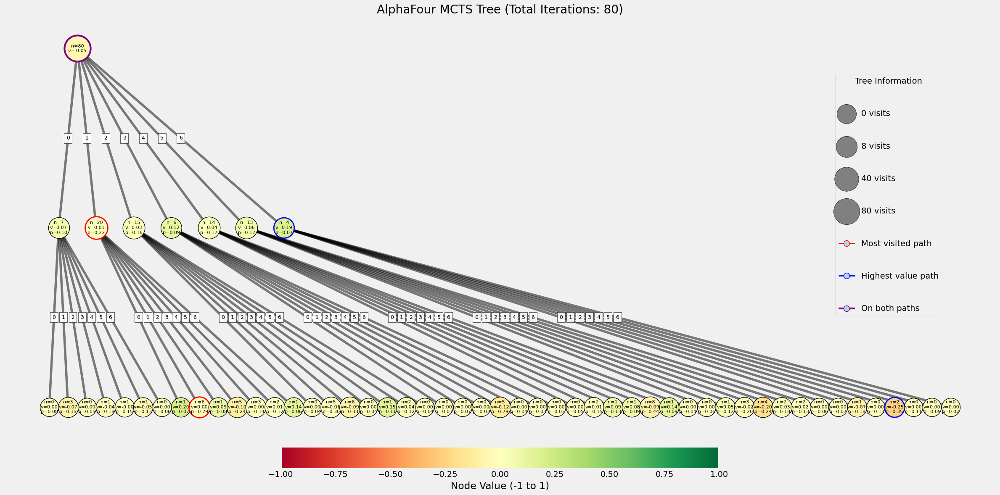

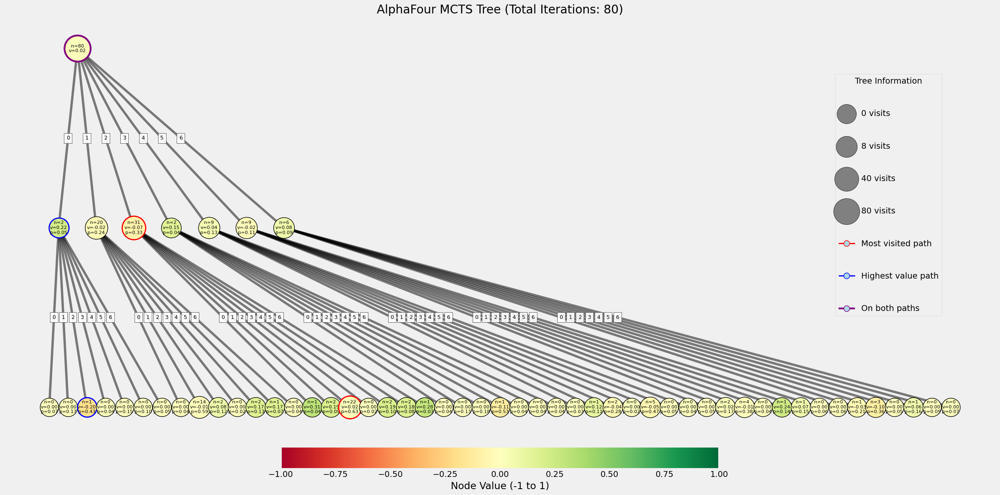

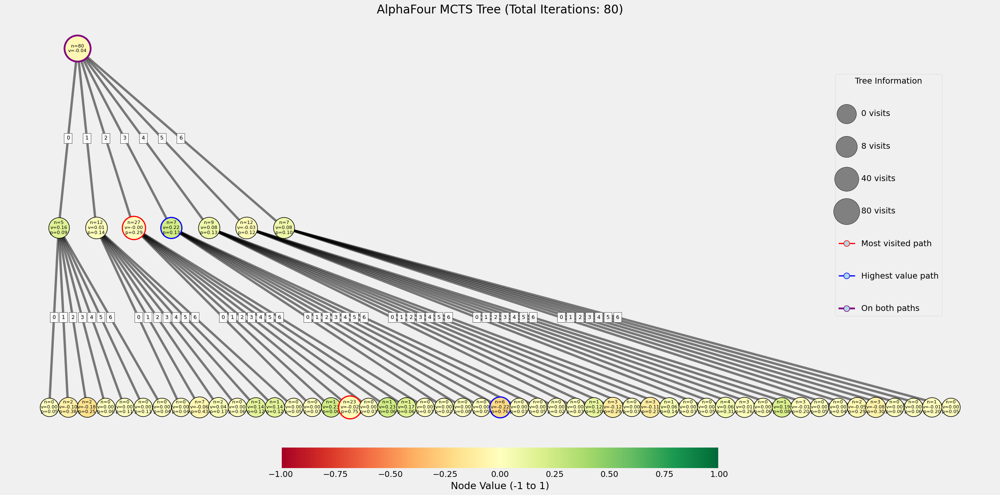

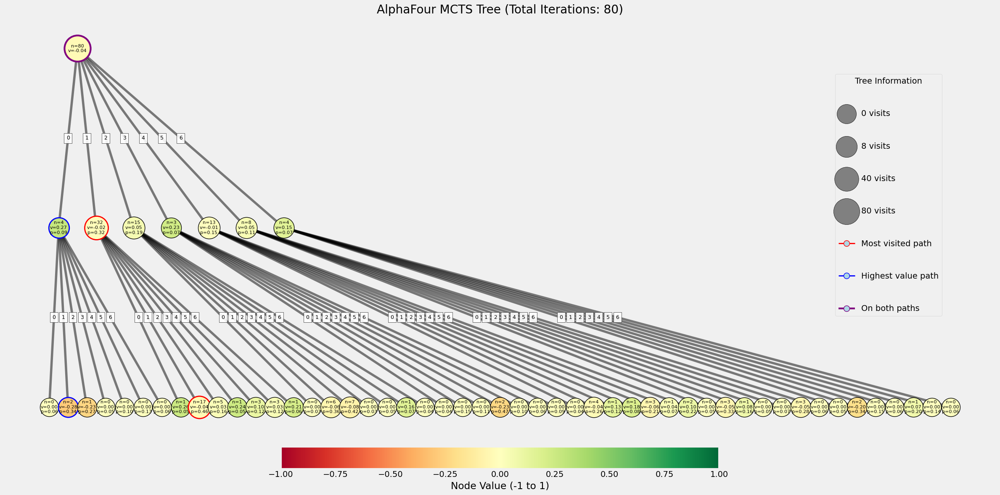

...

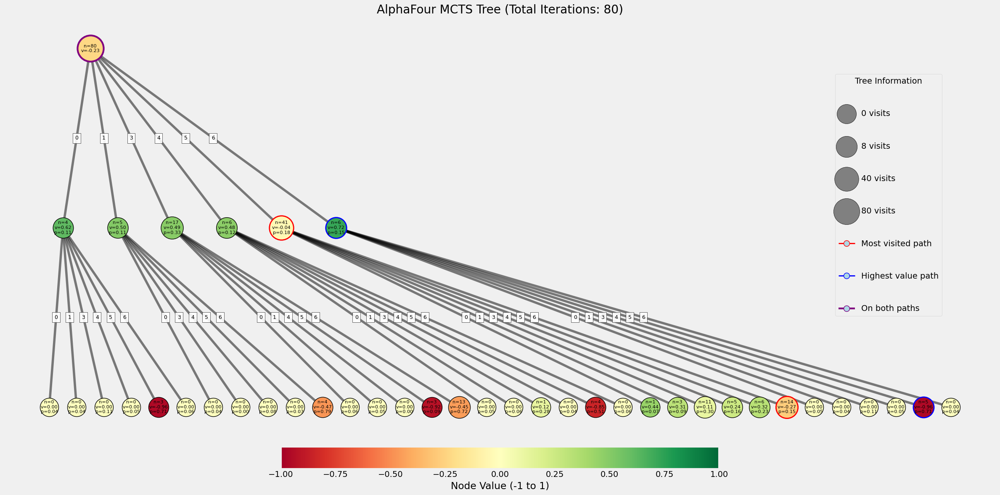

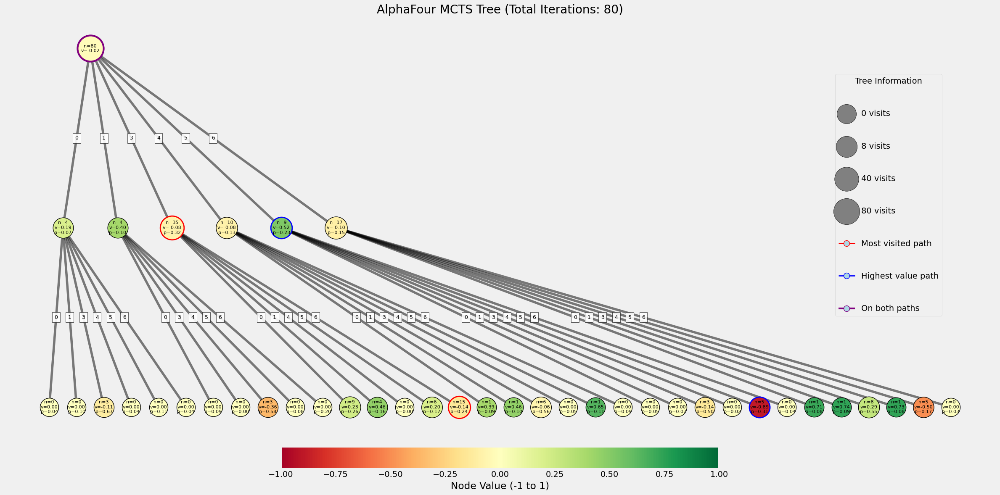

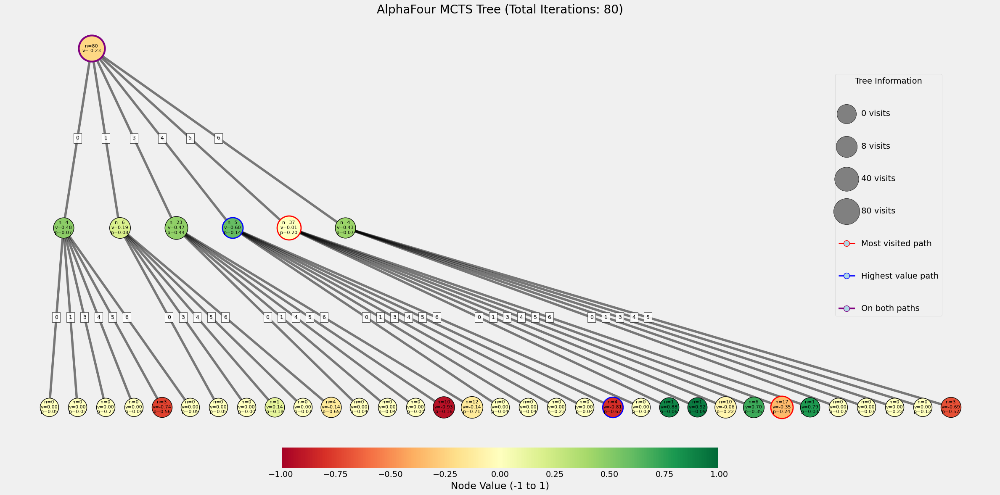

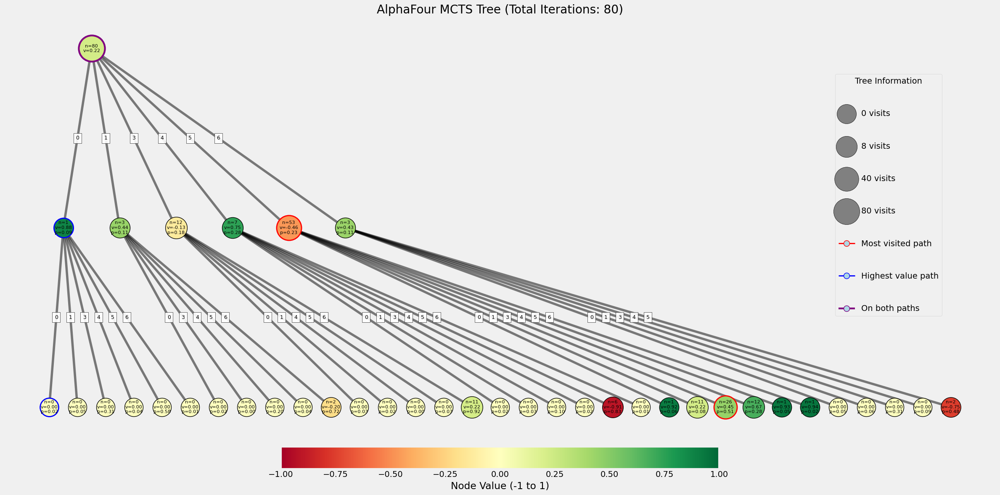

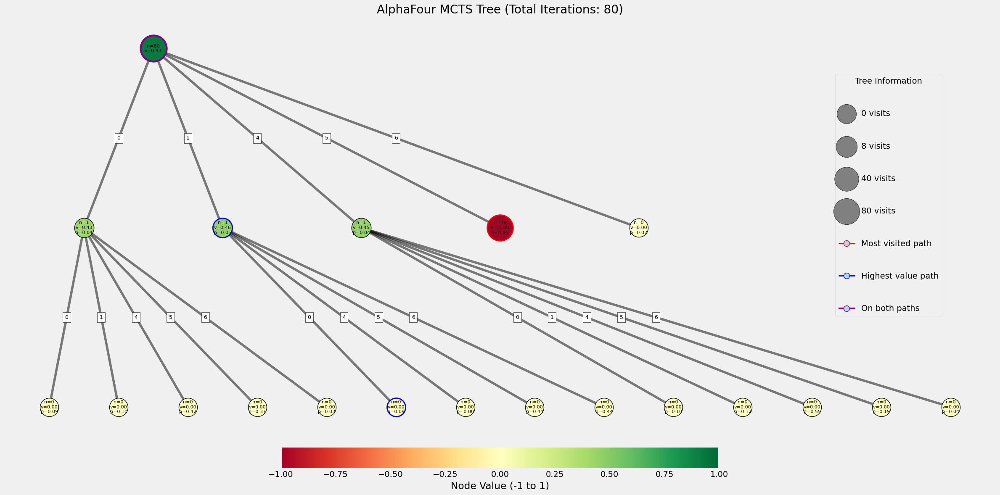

Total Games: 5000 Items in Memory: 166 Search Iterations: 79
Epoch 1: Policy Loss: 1.4051, Value Loss: 0.0401, Total Loss: 1.4452
Initial Evaluation Accuracy: 87.4%

Configuration:
  Exploration Constant: 2
  Temperature:          1.0
  Dirichlet Alpha:      1.0
  Dirichlet Epsilon:    0.25
  Residual Blocks:      4
  Filters per Block:    64

Results:
  Final Accuracy:       87.40%
  Average Accuracy:     63.09%
  Final Policy Loss:    1.4051
  Avg Policy Loss:      1.5781
  Final Value Loss:     0.0401
  Avg Value Loss:       0.0381
  Total Train Time:     17783.79 seconds



In [ ]:
# Main training/eval loop
last_epoch = False

train_start_time = time.time()
for train_epoch in range(config.training_epochs):
    if train_epoch == config.training_epochs - 1:
        last_epoch = True
    alphazero.train(1, last_epoch)
    evaluator.evaluate()
train_end_time = time.time()

# Total time
total_train_time = train_end_time - train_start_time

# Get evaluation stats
final_acc = evaluator.accuracies[-1]
avg_acc = sum(evaluator.accuracies) / len(evaluator.accuracies)

# Get training history
history = alphazero.get_training_history()
final_policy_loss = history['policy_losses'][-1]
avg_policy_loss = sum(history['policy_losses']) / len(history['policy_losses'])
final_value_loss = history['value_losses'][-1]
avg_value_loss = sum(history['value_losses']) / len(history['value_losses'])

results_dict = {
    'exploration_const': config.exploration_constant,
    'temperature': config.temperature,
    'dirichlet_alpha': config.dirichlet_alpha,
    'dirichlet_eps': config.dirichlet_eps,
    'n_res_blocks': config.n_res_blocks,
    'n_filters': config.n_filters,
    'final_acc': final_acc,
    'avg_acc': avg_acc,
    'final_policy_loss': final_policy_loss,
    'avg_policy_loss': avg_policy_loss,
    'final_value_loss': final_value_loss,
    'avg_value_loss': avg_value_loss,
    'total_train_time': total_train_time
}


print(f"""
Configuration:
  Exploration Constant: {results_dict['exploration_const']}
  Temperature:          {results_dict['temperature']}
  Dirichlet Alpha:      {results_dict['dirichlet_alpha']}
  Dirichlet Epsilon:    {results_dict['dirichlet_eps']}
  Residual Blocks:      {results_dict['n_res_blocks']}
  Filters per Block:    {results_dict['n_filters']}

Results:
  Final Accuracy:       {results_dict['final_acc'] * 100:.2f}%
  Average Accuracy:     {results_dict['avg_acc'] * 100:.2f}%
  Final Policy Loss:    {results_dict['final_policy_loss']:.4f}
  Avg Policy Loss:      {results_dict['avg_policy_loss']:.4f}
  Final Value Loss:     {results_dict['final_value_loss']:.4f}
  Avg Value Loss:       {results_dict['avg_value_loss']:.4f}
  Total Train Time:     {results_dict['total_train_time']:.2f} seconds
""")

# Save best model

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
model_path = '/content/drive/My Drive/ConnectFourModels/alphazero_model.pth'
alphazero.save(model_path)

Model saved to /content/drive/My Drive/ConnectFourModels/alphazero_model.pth


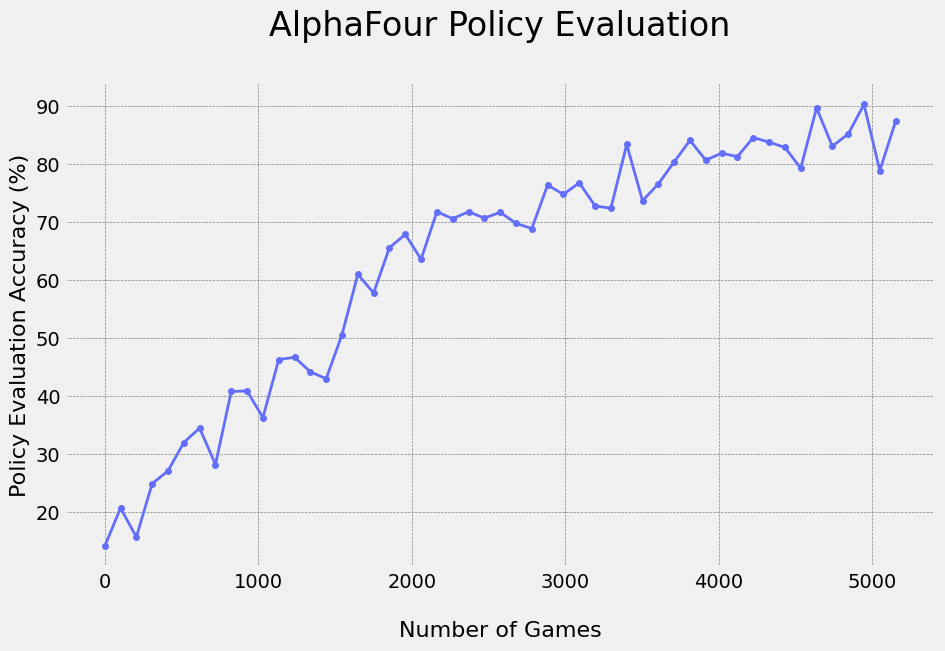

In [ ]:
# Plot data
x_values = np.linspace(0, 101 * len(evaluator.accuracies), len(evaluator.accuracies))
y_values = [acc * 100 for acc in evaluator.accuracies]

# Create plot
plt.figure(figsize=(10, 6))
plt.plot(x_values, y_values, linewidth=2, marker='o', markersize=4, linestyle='-', color='#636EFA')

# Formatting
plt.xlabel('\nNumber of Games', fontsize=16)
plt.ylabel('Policy Evaluation Accuracy (%)', fontsize=16)
plt.title('AlphaFour Policy Evaluation\n', fontsize=24)
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')

plt.show()

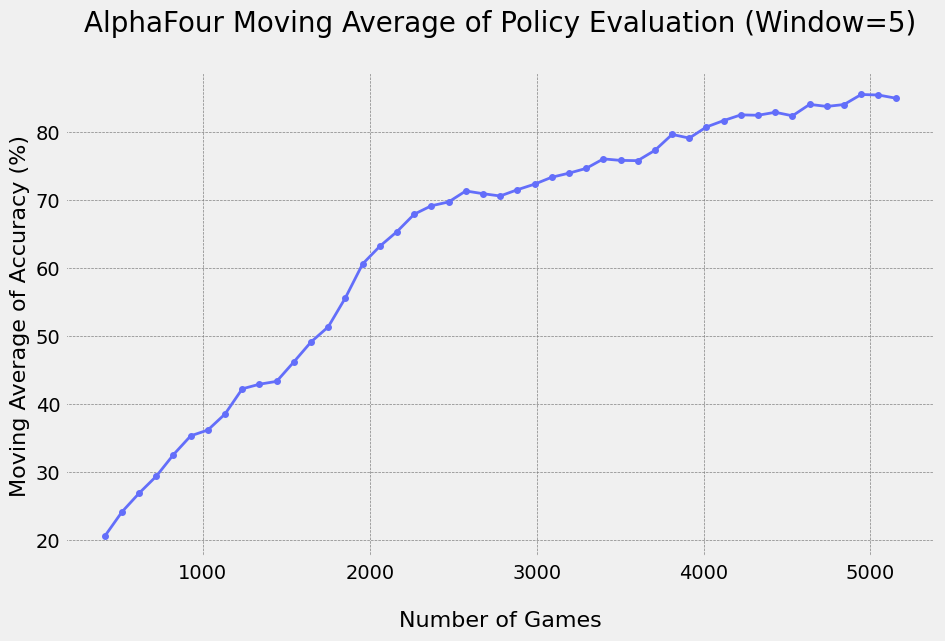

In [ ]:
window_size = 5  # Example window size for moving average
moving_avg = np.convolve(y_values, np.ones(window_size)/window_size, mode='valid')

plt.figure(figsize=(10, 6))
plt.plot(x_values[window_size-1:], moving_avg, linewidth=2, marker='o', markersize=4, linestyle='-', color='#636EFA')
plt.xlabel('\nNumber of Games', fontsize=16)
plt.ylabel('Moving Average of Accuracy (%)', fontsize=16)
plt.title(f'AlphaFour Moving Average of Policy Evaluation (Window={window_size})\n', fontsize=20)
plt.grid(True, linestyle='--', linewidth=0.5, color='gray')
plt.show()

## Loss curve functions

In [53]:
def plot_loss_curves(training_history, save_path=None, figsize=(12, 10)):
    """
    Plot the loss curves of the AlphaZero training process.

    Args:
        training_history (dict): Dictionary containing training metrics from AlphaZero.
        save_path (str, optional): Path to save the plot. If None, plot will be displayed.
        figsize (tuple, optional): Figure size. Default is (12, 8).
    """
    epochs = training_history['epochs']
    policy_losses = training_history['policy_losses']
    value_losses = training_history['value_losses']
    total_losses = training_history['total_losses']

    plt.figure(figsize=figsize)

    plt.subplot(3, 1, 1)
    plt.plot(epochs, policy_losses, 'b-', label='Policy Loss', lw=2)
    plt.title('AlphaFour Policy Loss per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    plt.subplot(3, 1, 2)
    plt.plot(epochs, value_losses, 'r-', label='Value Loss', lw=2)
    plt.title('AlphaFour Value Loss per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    plt.subplot(3, 1, 3)
    plt.plot(epochs, total_losses, 'g-', label='Total Loss', lw=2)
    plt.title('AlphaFour Total Loss per Epoch')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        plt.close()
        print(f"Loss curves saved to {save_path}")
    else:
        plt.show()

def plot_combined_losses(training_history, save_path=None, figsize=(12, 10)):
    """
    Plot all losses on a single graph with a logarithmic scale.

    Args:
        training_history (dict): Dictionary containing training metrics from AlphaZero.
        save_path (str, optional): Path to save the plot. If None, plot will be displayed.
        figsize (tuple, optional): Figure size. Default is (10, 6).
    """
    epochs = training_history['epochs']
    policy_losses = training_history['policy_losses']
    value_losses = training_history['value_losses']
    total_losses = training_history['total_losses']

    plt.figure(figsize=figsize)

    plt.plot(epochs, policy_losses, 'b-', label='Policy Loss', lw=2)
    plt.plot(epochs, value_losses, 'r-', label='Value Loss', lw=2)
    plt.plot(epochs, total_losses, 'g-', label='Total Loss', lw=2)

    plt.title('AlphaFour Training Losses Over Time')
    plt.xlabel('Epoch')
    plt.ylabel('Loss (Log Scale)')
    plt.grid(True)
    plt.legend()
    plt.yscale('log')  # Use log scale to better see trends

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        plt.close()
        print(f"Combined loss curve saved to {save_path}")
    else:
        plt.show()

def plot_loss_ratio(training_history, save_path=None, figsize=(12, 10)):
    """
    Plot the ratio of policy loss to value loss over time.

    Args:
        training_history (dict): Dictionary containing training metrics from AlphaZero.
        save_path (str, optional): Path to save the plot. If None, plot will be displayed.
        figsize (tuple, optional): Figure size. Default is (10, 6).
    """
    epochs = training_history['epochs']
    policy_losses = np.array(training_history['policy_losses'])
    value_losses = np.array(training_history['value_losses'])

    # Calculate ratio (avoid division by zero)
    ratio = np.divide(policy_losses, value_losses,
                     out=np.zeros_like(policy_losses),
                     where=value_losses!=0)

    plt.figure(figsize=figsize)
    plt.plot(epochs, ratio, 'purple', label='Policy/Value Ratio', lw=2)
    plt.axhline(y=1.0, color='gray', linestyle='--', alpha=0.7)

    plt.title('AlphaFour Ratio of Policy Loss to Value Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Ratio')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        plt.close()
        print(f"Loss ratio plot saved to {save_path}")
    else:
        plt.show()

def save_losses_to_csv(training_history, file_path):
    """
    Save loss history to a CSV file.

    Args:
        training_history (dict): Dictionary containing training metrics from AlphaZero.
        file_path (str): Path to save the CSV file.
    """
    df = pd.DataFrame({
        'Epoch': training_history['epochs'],
        'Policy_Loss': training_history['policy_losses'],
        'Value_Loss': training_history['value_losses'],
        'Total_Loss': training_history['total_losses']
    })

    df.to_csv(file_path, index=False)
    print(f"Loss history saved to {file_path}")

def plot_rolling_average_losses(training_history, window=5, save_path=None, figsize=(12, 10)):
    """
    Plot losses with a rolling average to smooth out noise.

    Args:
        training_history (dict): Dictionary containing training metrics from AlphaZero.
        window (int): Size of the rolling window for averaging.
        save_path (str, optional): Path to save the plot. If None, plot will be displayed.
        figsize (tuple, optional): Figure size. Default is (10, 6).
    """
    epochs = training_history['epochs']
    policy_losses = training_history['policy_losses']
    value_losses = training_history['value_losses']
    total_losses = training_history['total_losses']

    # Convert to pandas for easy rolling average
    df = pd.DataFrame({
        'Epoch': epochs,
        'Policy_Loss': policy_losses,
        'Value_Loss': value_losses,
        'Total_Loss': total_losses
    })

    # Calculate rolling averages
    if len(df) >= window:
        policy_rolling = df['Policy_Loss'].rolling(window=window, center=True).mean()
        value_rolling = df['Value_Loss'].rolling(window=window, center=True).mean()
        total_rolling = df['Total_Loss'].rolling(window=window, center=True).mean()
    else:
        # Not enough data points for the specified window
        policy_rolling = df['Policy_Loss']
        value_rolling = df['Value_Loss']
        total_rolling = df['Total_Loss']
        print(f"Warning: Not enough data points for window size {window}. Using raw data.")

    plt.figure(figsize=figsize)

    # Raw data (light colors)
    plt.plot(epochs, policy_losses, 'b-', alpha=0.3, label='Policy Loss (Raw)')
    plt.plot(epochs, value_losses, 'r-', alpha=0.3, label='Value Loss (Raw)')
    plt.plot(epochs, total_losses, 'g-', alpha=0.3, label='Total Loss (Raw)')

    # Smoothed data (bold colors)
    plt.plot(epochs, policy_rolling, 'b-', linewidth=2, label=f'Policy Loss ({window}-Epoch MA)')
    plt.plot(epochs, value_rolling, 'r-', linewidth=2, label=f'Value Loss ({window}-Epoch MA)')
    plt.plot(epochs, total_rolling, 'g-', linewidth=2, label=f'Total Loss ({window}-Epoch MA)')

    plt.title(f'AlphaFour Training Losses with {window}-Epoch Moving Average')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path)
        plt.close()
        print(f"Smoothed loss curves saved to {save_path}")
    else:
        plt.show()

## Loss curve plots

{'epochs': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50], 'policy_losses': [1.9730437497297924, 1.9425849169492722, 1.9319695333639781, 1.9167648653189342, 1.9090748031934102, 1.8425680220127105, 1.5940214941898982, 1.6678201854228973, 1.6993467271327973, 1.4247683227062224, 1.7205428779125214, 1.5230881035327912, 1.5082167088985443, 1.5119962573051453, 1.3893536776304245, 1.5347793499628704, 1.538162112236023, 1.534866554396493, 1.595257614340101, 1.6021991755281175, 1.577575764485768, 1.581433240856443, 1.57466174023492, 1.5569062493741512, 1.514789193868637, 1.504004366695881, 1.5600191321637895, 1.535559845822198, 1.598370935767889, 1.5295732133090496, 1.5474686324596405, 1.538443461060524, 1.5764280185103416, 1.561247531324625, 1.5153998831907909, 1.526234473500933, 1.518082495778799, 1.5243750177323818, 1.5106840431690216, 1.49621966853

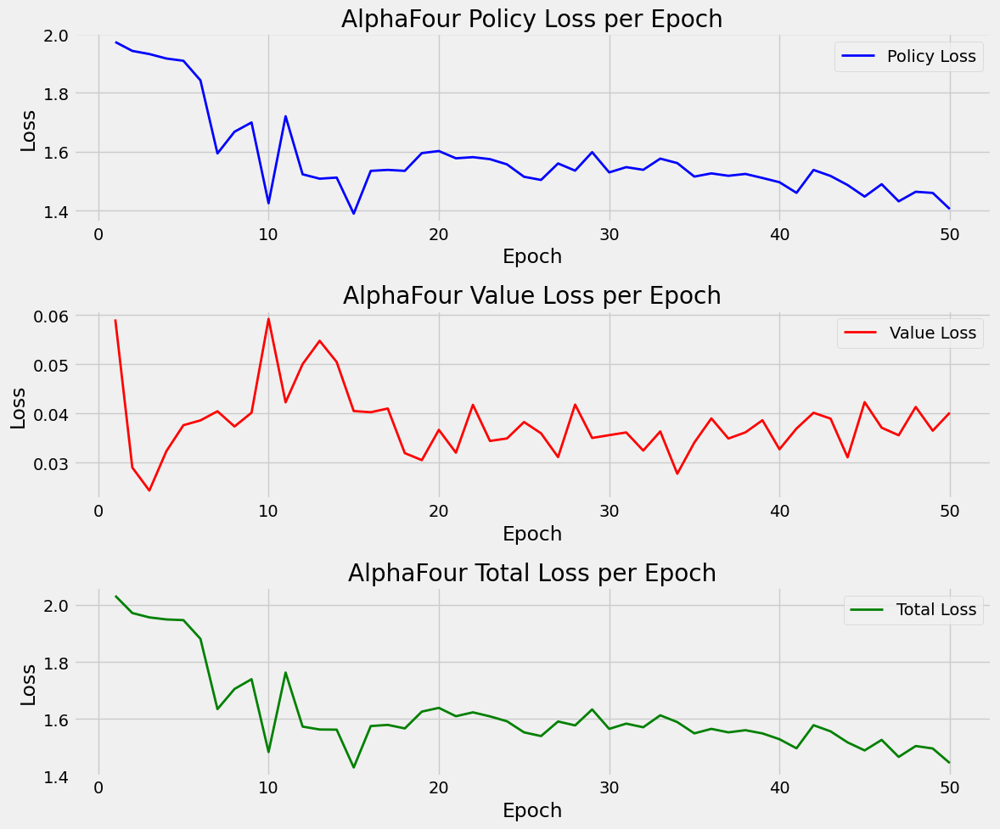

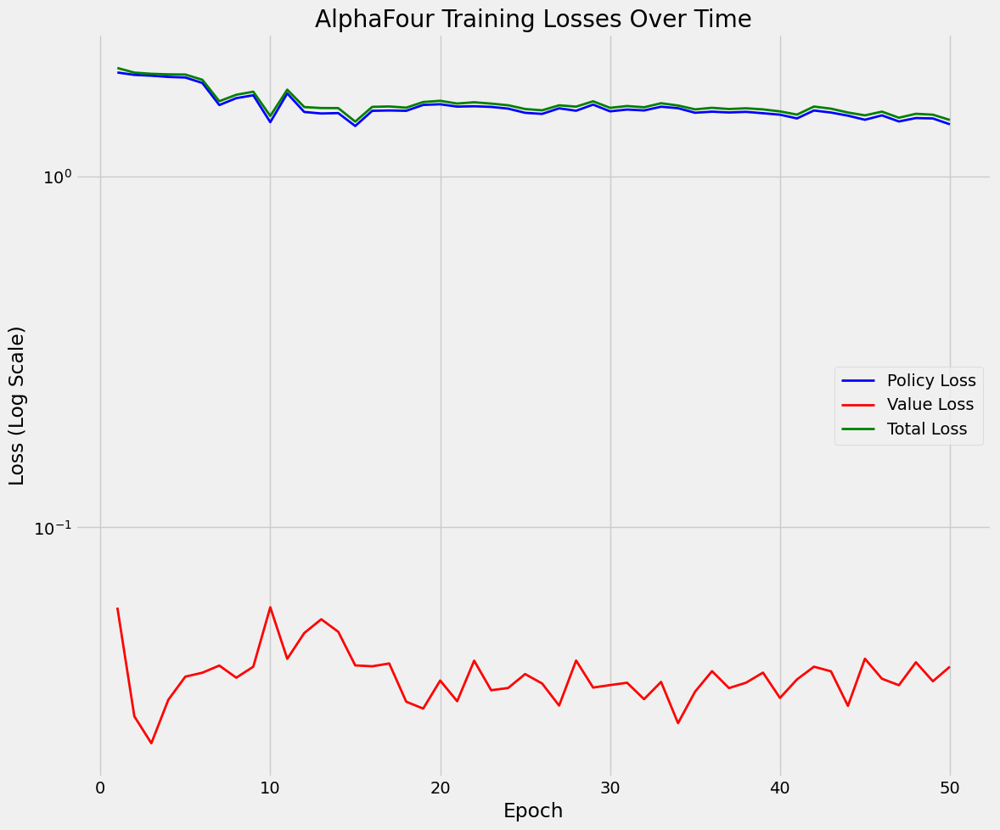

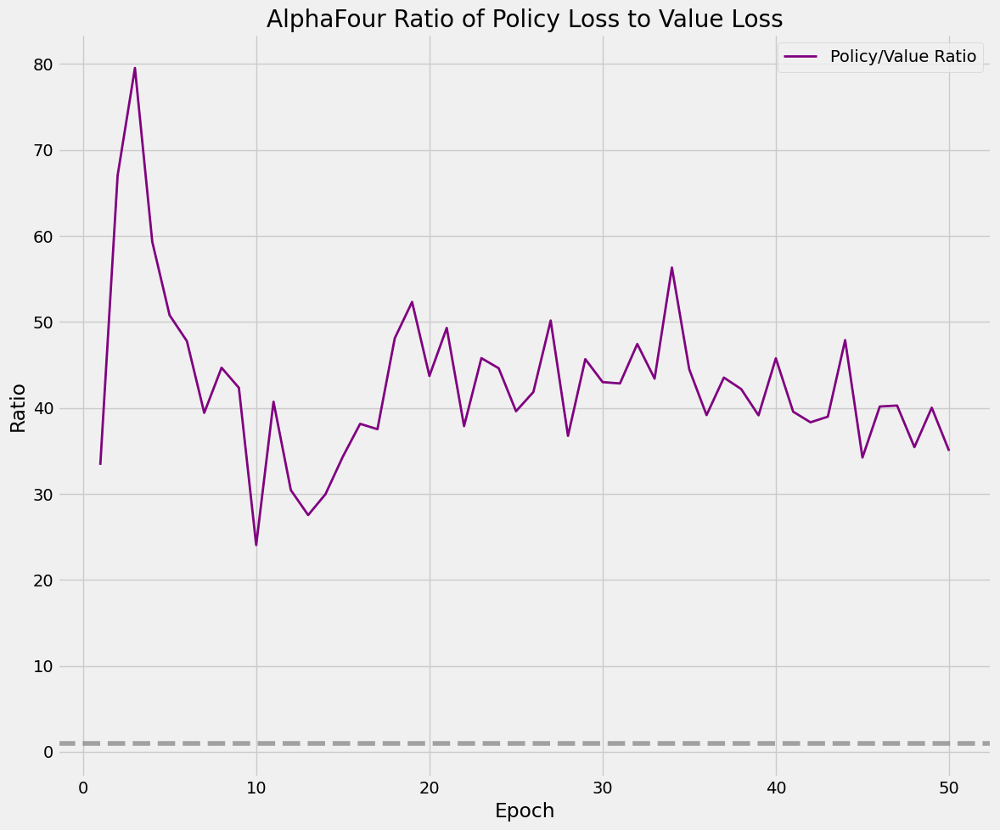

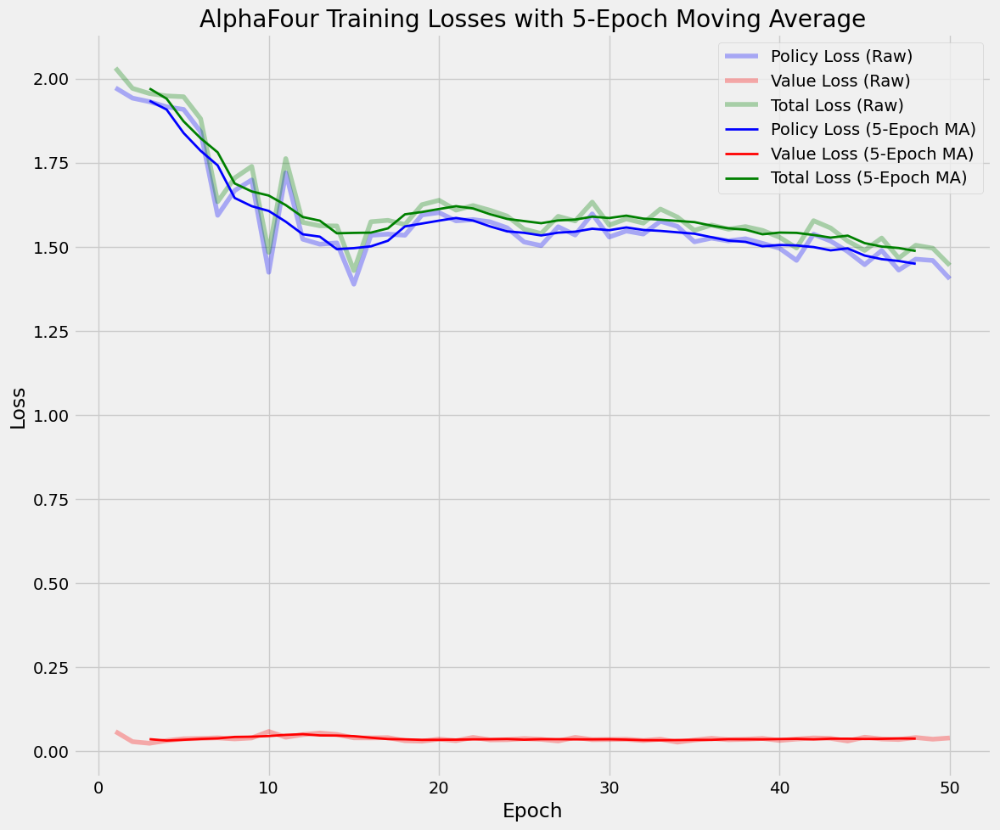

In [54]:
# Get the training history from the agent
training_history = alphazero.get_training_history()

print(training_history)

# Generate different visualizations
plot_loss_curves(training_history)

# Plot losses on a single graph with log scale
plot_combined_losses(training_history)

# Plot the ratio of policy loss to value loss
plot_loss_ratio(training_history)

# Plot losses with a rolling average to smooth out noise
plot_rolling_average_losses(training_history, window=5)

# Adapt to play with other bots

In [ ]:
class AlphaZeroAgentAdapter:
    def __init__(self, alphazero_agent, mcts_search_iterations=400):
        """
        Adapter to make AlphaZero agent compatible with ConnectFourEnv

        Parameters:
            alphazero_agent: Your trained AlphaZero agent
            mcts_search_iterations: Number of MCTS iterations to perform per move
        """
        self.agent = alphazero_agent
        self.mcts = alphazero_agent.mcts
        self.game = alphazero_agent.game
        self.search_iterations = mcts_search_iterations

    def getName(self):
        """Required by ConnectFourEnv"""
        return "AlphaZero"

    def play(self, board):
        """
        Interface required by ConnectFourEnv
        Gets the best action from AlphaZero's MCTS

        Parameters:
            board: ConnectFourEnv board (-1 for opponent, 1 for agent)

        Returns:
            action: Integer representing column to play (0-6)
        """
        # In ConnectFourEnv, the current player is always represented as 1
        # Your AlphaZero expects the board from perspective of player 1
        # So we can use the board directly

        # Check if board is valid before proceeding
        valid_actions = self.game.get_valid_actions(board)
        if len(valid_actions) == 0:
            # No valid moves, should not happen in normal play
            return 0

        # Use your AlphaZero MCTS to select an action
        action, _ = self.mcts.search(board, self.search_iterations, temperature=0)

        return action

# Evaluate against opponents

## Load saved model in if needed

In [ ]:
# model_path = '/content/drive/My Drive/ConnectFourModels/alphazero_model.pth'

# # Create an instance of your model class
# game = Connect4()
# alphazero = AlphaZero(game=game, config=config, verbose=True)

# # Load the saved model
# alphazero.load(model_path)

In [ ]:
def evaluate_against_opponents(alphazero_agent, opponents_list, num_games=100, render_mode=None):
    """
    Evaluate AlphaZero against multiple opponents

    Parameters:
        alphazero_agent: Your trained AlphaZero agent
        opponents_list: List of opponent objects
        num_games: Number of games to play per opponent
        render_mode: None or "human" for visualization

    Returns:
        Dictionary of results per opponent
    """
    # Create adapter
    alphazero_adapter = AlphaZeroAgentAdapter(
        alphazero_agent,
        mcts_search_iterations=config.mcts_max_search_iter  # Use maximum search iterations for best play
    )

    results = {}

    for opponent in opponents_list:
        opponent_name = opponent.getName()
        print(f"\nEvaluating against: {opponent_name}")

        # Initialize a grid to track AlphaZero's moves (Connect 4 grid)
        move_heatmap = np.zeros((6, 7))  # Assuming 6 rows and 7 columns for Connect Four

        wins = 0
        losses = 0
        draws = 0

        for game_idx in range(num_games):
            # Create environment with the opponent
            env = ConnectFourEnv(opponent=opponent, render_mode=render_mode)
            observation, _ = env.reset()

            done = False
            while not done:
                # AlphaZero selects an action
                action = alphazero_adapter.play(observation)

                # print(action)

                # Track the move for heatmap (increase the count in the selected column)
                row = np.where(observation[:, action] == 0)[0][-1]
                move_heatmap[row, action] += 1  # Increment the count for the chosen column

                # Take action in environment
                observation, reward, done, _, _ = env.step(action)

                if done:
                    if reward > 0:
                        wins += 1  # AlphaZero won
                    elif reward < 0:
                        losses += 1  # Opponent won
                    else:
                        draws += 1  # Draw

                    # Print progress
                    win_rate = wins / (game_idx + 1) * 100
                    print(f"\rGame {game_idx+1}/{num_games}: Win rate: {win_rate:.1f}%, Wins: {wins}, Draws: {draws}, Losses: {losses}", end="")

        # Calculate final rates
        win_rate = wins / num_games * 100
        draw_rate = draws / num_games * 100
        loss_rate = losses / num_games * 100

        print(f"\nFinal results against {opponent_name}:")
        print(f"Win rate: {win_rate:.1f}%")
        print(f"Draw rate: {draw_rate:.1f}%")
        print(f"Loss rate: {loss_rate:.1f}%")

        results[opponent_name] = {
            'win_rate': win_rate,
            'draw_rate': draw_rate,
            'loss_rate': loss_rate,
            'move_heatmap': move_heatmap  # Add the heatmap data to the results
        }

    return results

In [28]:
# Initialize game
game = Connect4()

# # Load your trained model
# model_path = 'alphazero-network-weights.pth'
# alphazero = load_alphazero_agent(model_path, game, config)

# Create list of opponents
opponents = [
    BabySmarterPlayer(),
    ChildSmarterPlayer(),
    TeenagerSmarterPlayer(),
    AdultSmarterPlayer()
]

# Evaluate against each opponent
results = evaluate_against_opponents(
    alphazero,
    opponents,
    num_games=100,  # Adjust as needed
    render_mode=None  # Set to "human" to visualize
)

# Print summary of results
print("\n--- Summary of Results ---")
for opponent_name, stats in results.items():
    print(f"{opponent_name}: Win {stats['win_rate']:.1f}%, Draw {stats['draw_rate']:.1f}%, Loss {stats['loss_rate']:.1f}%")


Evaluating against: BabySmarterPlayer
Game 100/100: Win rate: 100.0%, Wins: 100, Draws: 0, Losses: 0
Final results against BabySmarterPlayer:
Win rate: 100.0%
Draw rate: 0.0%
Loss rate: 0.0%

Evaluating against: ChildSmarterPlayer
Game 100/100: Win rate: 99.0%, Wins: 99, Draws: 1, Losses: 0
Final results against ChildSmarterPlayer:
Win rate: 99.0%
Draw rate: 1.0%
Loss rate: 0.0%

Evaluating against: TeenagerSmarterPlayer
Game 100/100: Win rate: 95.0%, Wins: 95, Draws: 2, Losses: 3
Final results against TeenagerSmarterPlayer:
Win rate: 95.0%
Draw rate: 2.0%
Loss rate: 3.0%

Evaluating against: AdultSmarterPlayer
Game 100/100: Win rate: 96.0%, Wins: 96, Draws: 0, Losses: 4
Final results against AdultSmarterPlayer:
Win rate: 96.0%
Draw rate: 0.0%
Loss rate: 4.0%

--- Summary of Results ---
BabySmarterPlayer: Win 100.0%, Draw 0.0%, Loss 0.0%
ChildSmarterPlayer: Win 99.0%, Draw 1.0%, Loss 0.0%
TeenagerSmarterPlayer: Win 95.0%, Draw 2.0%, Loss 3.0%
AdultSmarterPlayer: Win 96.0%, Draw 0.0%, 

## Win/draw/loss figure

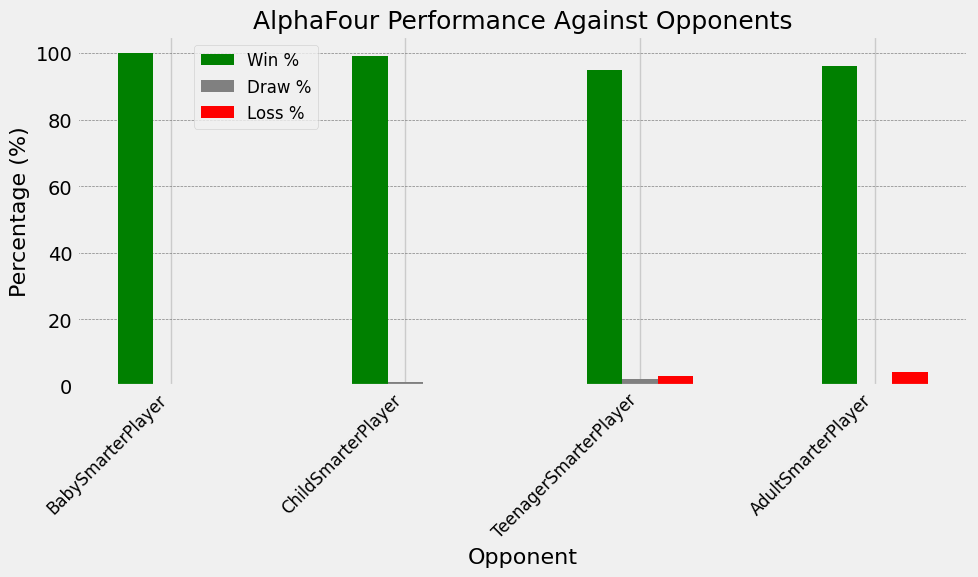

In [37]:
# Prepare the data
opponent_names = list(results.keys())
win_rates = [stats['win_rate'] for stats in results.values()]
draw_rates = [stats['draw_rate'] for stats in results.values()]
loss_rates = [stats['loss_rate'] for stats in results.values()]

# Set up the bar positions
x = np.arange(len(opponent_names))
width = 0.15  # Width of the bars

# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))

# Plotting the bars for win, draw, and loss rates
ax.bar(x - width, win_rates, width, label='Win %', color='green')
ax.bar(x, draw_rates, width, label='Draw %', color='gray')
ax.bar(x + width, loss_rates, width, label='Loss %', color='red')

# Labeling and formatting
ax.set_xlabel('Opponent', fontsize=16)
ax.set_ylabel('Percentage (%)', fontsize=16)
ax.set_title('AlphaFour Performance Against Opponents', fontsize=18)
ax.set_xticks(x)
ax.set_xticklabels(opponent_names, rotation=45, ha='right', fontsize=12)

# Move the legend to the top-right but slightly to the left
ax.legend(loc='upper right', bbox_to_anchor=(0.28, 1.0), fontsize=12)

# Show grid for better readability
ax.grid(True, axis='y', linestyle='--', linewidth=0.5, color='gray')

# Display the plot
plt.tight_layout()
plt.show()


## Heatmap of move locations

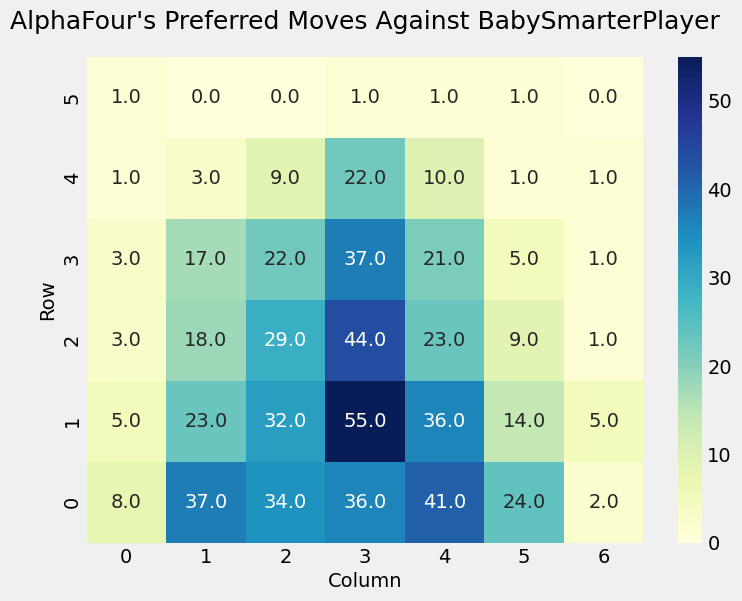

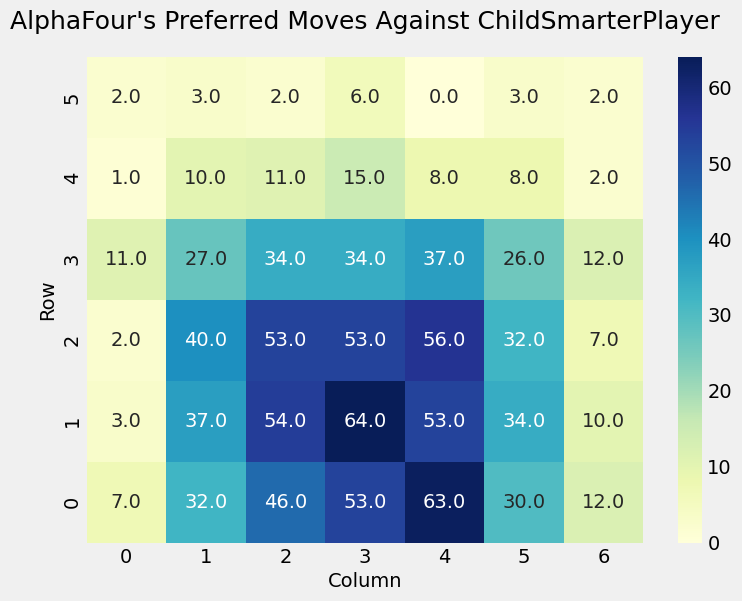

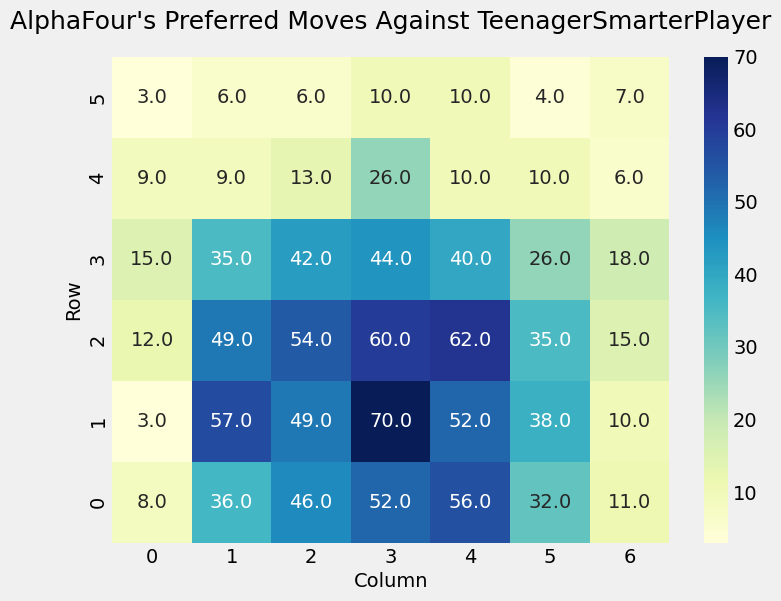

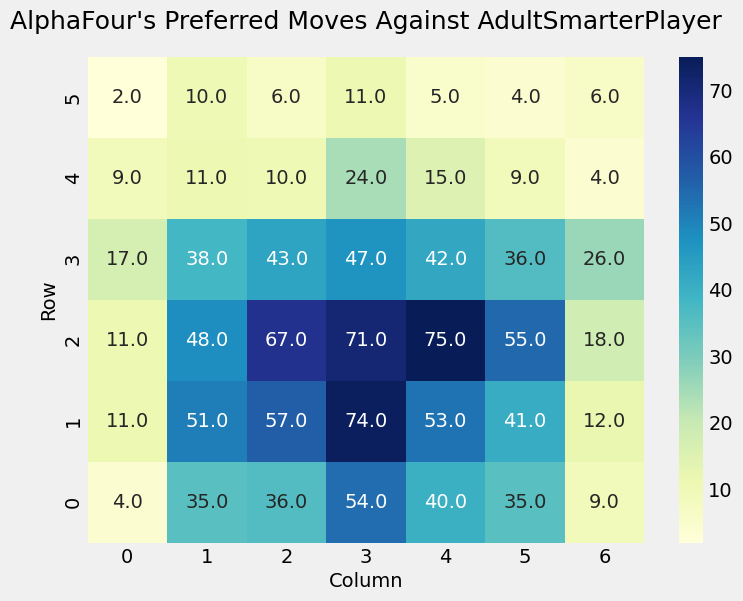

In [38]:
# Function to plot the heatmap for each opponent
def plot_move_heatmap(results):
    for opponent_name, data in results.items():
        move_heatmap = data['move_heatmap']

        # Plot the heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(move_heatmap, annot=True, cmap="YlGnBu", fmt=".1f", cbar=True,
                    xticklabels=['0', '1', '2', '3', '4', '5', '6'], yticklabels=['5', '4', '3', '2', '1', '0'])

        plt.title(f"AlphaFour's Preferred Moves Against {opponent_name}", fontsize=18, pad=20)
        plt.xlabel("Column", fontsize=14)
        plt.ylabel("Row", fontsize=14)
        plt.show()

# Call the function to plot the heatmaps
plot_move_heatmap(results)

# Testing integration

In [57]:
# Create adapater to work for desired env
alphazero_player = AlphaZeroAgentAdapter(alphazero, mcts_search_iterations=400)

# Make env
env = ConnectFourEnv(opponent=alphazero_player, render_mode=None)  # Can't use "human" mode
observation, _ = env.reset()

# Play manually
done = False

def print_board(board, turn):
    print(f"\nCurrent board for turn {turn}:\n")
    print("   0  1  2  3  4  5  6 ")
    print("   ------------------- ")
    print(board)

turn = 1
print_board(env.board, turn)

while not done:
    turn += 1
    # Get human player action
    action = int(input("Enter column (0-6): "))

    # Take action in environment
    observation, reward, done, _, _ = env.step(action)

    # Print updated board
    print_board(env.board, turn)


    if done:
        if reward > 0:
            print("\nYou won!")
        elif reward < 0:
            print("\nAlphaFour won!")
        else:
            print("\nDraw!")



Current board for turn 1:

   0  1  2  3  4  5  6 
   ------------------- 
[[ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0 -1  0  0  0  0  0]]
Enter column (0-6): 3

Current board for turn 2:

   0  1  2  3  4  5  6 
   ------------------- 
[[ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0 -1  0  0  0]
 [ 0 -1  0  1  0  0  0]]
Enter column (0-6): 3

Current board for turn 3:

   0  1  2  3  4  5  6 
   ------------------- 
[[ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0 -1  0  0  0]
 [ 0  0  0  1  0  0  0]
 [ 0  0  0 -1  0  0  0]
 [ 0 -1  0  1  0  0  0]]
Enter column (0-6): 1

Current board for turn 4:

   0  1  2  3  4  5  6 
   ------------------- 
[[ 0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0]
 [ 0  0  0 -1  0  0  0]
 [ 0 -1  0  1  0  0  0]
 [ 0  1  0 -1  0  0  0]
 [ 0 -1  0  1  0  0  0]]
Enter column (0-6): 1

Current board for turn 5:

